# PHYS6318: Lecture 3

In [102]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
from matplotlib import rcParams
rcParams['animation.html'] = 'jshtml'
from matplotlib.animation import FuncAnimation
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
import netCDF4
import time
import os
import glob

# OMB Chapter 4: Long Waves in a Channel

## OMB 4.1 More on Finite Differences

Review Taylor Series and derivations of difference schemes. Discuss truncation error.

## OMB 4.2 Long Surface Gravity Waves

Equations governing the dynamics of **long** surface waves can be written as:
 
$$\begin{align}
\frac{\partial u}{\partial t} &= - g \frac{\partial \eta}{\partial x} \\
\frac{\partial \eta}{\partial t} &= - \frac{(u h)}{\partial x} \\
\end{align}$$

where $u$ is speed in the $x$-direction, $t$ is time, $g$ is acceleration due to gravity, $\eta$ is sea-level elevation, and $h$ is total water depth.The first equation is an expression of Newton’s laws of motions and states that aslope in the sea surface operates to change the lateral velocity. The second equation – the vertically integrated form of the continuity equation – relates temporal changesin sea level to convergence/divergence of the depth-integrated lateral flow



### 4.2.5 Analytical Wave Solution

Total  water  depth $h$ can  be  approximated  as  constant  for  a  flat  seafloor  togetherwith wave amplitudes small compared with total water depth. In this case, the wavesolution of the above equations is:

$$\begin{align}
\eta(t, x) &= \eta_0 \sin (2\pi x/\lambda - 2\pi t / T) \\
u(t, x) &= u_0 \sin (2\pi x/\lambda - 2\pi t / T) 
\end{align}
$$

where $\eta_0$ is wave amplitude, $\lambda$ is wavelength, $T$ is wave period, and the magnitudeof $u$ is given by:

$$ u_0 = \eta_0 \sqrt{\frac{g}{h}} $$

From the continuity equation we can derive the solution for vertical speed of a fluid parcel as a function of depth:

$$ w(t, x, z^*) = -2 \pi u_0 z^* / \lambda \cos (2\pi x/\lambda - 2\pi t / T) $$

where $z^∗$ is (positive) distance from the seafloor.

### 4.2.6 Animation Script

In [103]:
def visualize_long_waves():
    
    # create figure for animation
    fig, ax = plt.subplots(figsize=(4, 3), # fig size in inches
                           constrained_layout=True)
    
    λ = 500
    η0 = 1
    h = 20
    g = 9.81
    c = np.sqrt(g*h)
    T = λ / c
    u0 = η0 *  np.sqrt(g/h)
    
    tmax = 2*T # simulate 2 wave periods
    dt = tmax/100 # time step
    t = np.arange(0, tmax, dt)
    
    xmax = 2*λ
    
    # initial locations of fluid parcels
    x = np.linspace(0.0, xmax, 20)
    z = np.array([1.0, 6, 11, 16])
    
    Z, X = np.meshgrid(z, x)
    zpos, xpos = np.meshgrid(z, x)
    
    line1, = ax.plot([], [], 'wo', mec='k')
    line2, = ax.plot([], [], 'wo', mec='k')
    line3, = ax.plot([], [], 'wo', mec='k')
    line4, = ax.plot([], [], 'wo', mec='k')
    line_surface, = ax.plot([], [], 'b-')
    
    def init():
        ax.set_xlabel('x (m)')
        ax.set_ylabel('z (m)')
        ax.set_xlim(0, xmax)
        ax.set_ylim(-20, 2)
        
        return line1, line2, line3, line4, line_surface

    def update(frame):
        
        # solution for η
        η = η0 * np.sin(2*np.pi * (x/λ - t[frame]/T))
        # solution for u
        u = u0 * np.sin(2*np.pi * (X/λ - t[frame]/T))
        # vertical gradient of w
        dwdz = -2*np.pi*u0/λ*np.cos(2*np.pi*(X/λ - t[frame]/T))
        
        # new locations (note use of [:] to update array)
        xpos[:] = xpos + dt*u
        w = dwdz*zpos
        zpos[:] = zpos + dt*w
        
        line1.set_data(xpos[:, 0], -h + zpos[:, 0])
        line2.set_data(xpos[:, 1], -h + zpos[:, 1])
        line3.set_data(xpos[:, 2], -h + zpos[:, 2])
        line4.set_data(xpos[:, 3], -h + zpos[:, 3])
        
        line_surface.set_data(x, η)
        
        return line1, line2, line3, line4, line_surface
    
    
    anim = FuncAnimation(fig, update, 
                         frames=len(t),
                         init_func=init, blit=True)

    plt.close()
    
    return anim

anim = visualize_long_waves()
anim

### 4.2.7 Numerical Grid

To solve 

$$\begin{align}
\frac{\partial u}{\partial t} &= - g \frac{\partial \eta}{\partial x} \\
\frac{\partial \eta}{\partial t} &= - \frac{(u h)}{\partial x} \\
\end{align}$$

numerically, we first need to define a numerical grid.  We  use  a  spatial  grid  of  constant  grid  spacing  in  which  velocity  grid  points  arelocated halfway between adjacent sea-level grid points. (See Fig 4.5) This is called a *staggered* grid.



For example, we could model a channel that is a length of 100 m being resolved with a grid spacing of $\Delta x = 10$ m.  We choose 10 grid cells in the x-direction plus another grid cell on each of the channel as boundary grid points.  With the choice of an uneven number of grid points, the centre of the channel is defined by a single grid cell.

In [104]:
xmax = 100
dx = 10
nx = 10

In [105]:
eta = np.zeros(nx+2)
u = np.zeros(nx+2)

Notice that that even though `eta` and `u` are the same length of arrays, they are evaluated at staggered locations.

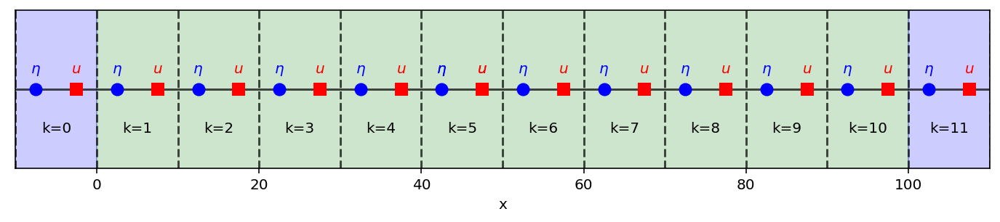

In [106]:
# see Fig 4.7 for details of the staggered grid
x_eta = np.arange(-0.75 * dx, xmax+dx, dx)
x_u = x_eta + 0.5 * dx

fig, ax = plt.subplots(figsize=(12, 2))

plt.axhline(0, color='k', alpha=0.7)

for k in range(nx+2):
    x = -dx + k*dx
    plt.axvline(x, color='k', alpha=0.7, linestyle='--')
    plt.text(x + dx/2, -0.5, f'k={k}', horizontalalignment='center' , verticalalignment='center')
    plt.text(x_eta[k], 0.2, '$\eta$', color='blue', horizontalalignment='center')
    plt.text(x_u[k], 0.2, '$u$', color='red', horizontalalignment='center')
plt.axvline(x+dx, color='k', alpha=0.7, linestyle='--')

plt.xlabel('x')

plt.plot(x_eta, eta, 'o', color='blue', markersize=8, label='eta')
plt.plot(x_u, u, 's', color='red', markersize=8, label='u')
plt.text(x_eta[nx//2], 0.2, '$\eta$', color='blue', horizontalalignment='center')
plt.text(x_u[nx//2], 0.2, '$u$', color='red', horizontalalignment='center')
plt.xlim(-dx, xmax + dx)
plt.ylim(-1, 1)
plt.yticks([])


plt.axvspan(0, xmax, color='g', alpha=0.2)
plt.axvspan(-dx, 0, color='b', alpha=0.2)
plt.axvspan(xmax, xmax+dx, color='b', alpha=0.2)
plt.show()

### 4.2.8 Finite-Difference Scheme

Using this staggered grid, we can write the momentum equation

$$\frac{\partial u}{\partial t} = - g \frac{\partial \eta}{\partial x}$$

as a using finite differences

$$\frac{u_k^{n+1} - u_k^n}{\Delta t} = - g \frac{\eta_{k+1}^n - \eta_k^n }{\Delta x}$$

and solve for $u_k^{n+1}$ to get

$$u_k^{n+1} = u_k^n - \Delta t g \left(\eta_{k+1}^n - \eta_k^n \right) \big/ \Delta x$$

where $n$ is time level, $k$ is grid index, $\Delta t$ is time step, and $\Delta x$ is grid spacing. 

To discretize the continuity equation
we consider a *control volume* (see Fig 4.6)

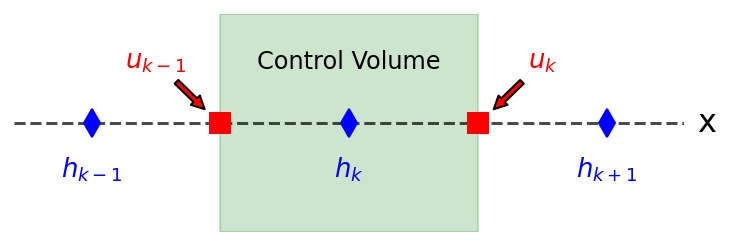

In [107]:
fig, ax = plt.subplots(figsize=(6, 2))
ax.axis("off")

plt.axhline(0, color='k', linestyle='--', alpha=0.7)
plt.plot([1,2,3], [0,0,0], 'bd', markersize=10,)
plt.plot([1.5, 2.5], [0,0], 'rs', markersize=10,)
plt.text(2, 0.5, 'Control Volume', horizontalalignment='center', size=12)
ax.annotate('$u_k$', xy=(2.55, 0.1), xytext=(2.75, 0.5),
            color='red',
            size=13,
            horizontalalignment='center',
            arrowprops=dict(facecolor='red',arrowstyle='simple'),
            )
ax.annotate('$u_{k-1}$', xy=(1.45, 0.1), xytext=(1.25, 0.5),
            color='red',
            size=13,
            horizontalalignment='center',
            arrowprops=dict(facecolor='red',arrowstyle='simple'),
            )
ax.text(1, -0.5, '$h_{k-1}$',  size=13, color='blue', horizontalalignment='center',)
ax.text(2, -0.5, '$h_{k}$',  size=13, color='blue', horizontalalignment='center',)
ax.text(3, -0.5, '$h_{k+1}$',  size=13, color='blue', horizontalalignment='center',)
ax.text(3.35, 0, 'x', size=16, color='black', verticalalignment='center')

plt.xlim(0.7, 3.3)
plt.ylim(-1, 1)

plt.axvspan(1.5, 2.5, color='g', alpha=0.2)
plt.show()

We write

$$\frac{\partial \eta}{\partial t} = - \frac{(u h)}{\partial x} $$

as the finite-difference

$$\frac{\eta_k^{*} - \eta_k^n}{\Delta t} = - \frac{u_{k}^{n+1}h_e - u_{k-1}^{n+1} h_w}{\Delta x}$$ 

and solve for $\eta_k^{*}$ to get

$$\eta_k^{*}  = \eta_k^n - \Delta t \left( u_{k}^{n+1}h_e - u_{k-1}^{n+1} \right) \big/ \Delta x$$ 


where $h_w$ and $h_e$ , respectively, are the layer thicknesses at the western and eastern faces of the control volume.  Notice we are using the value of $u^{n+1}$ computed in the previous step.

 The final prediction for $\eta^{n+1}$ will be slightly smoothed by applying a filter (see below) to $\eta^*$.

The choices for $h_w$ and $h_e$ are made dependent of the flow direction at the respected face in an upstream sense.  

## OMB 4.3 Exercise 5: Long Waves in a Channel

We make these globals so that they are available to all subroutines.

In [108]:
## global, fixed parameters

# grid parameters
xmax = 1010
dx = 10
dt = 0.1
nx = 101

tmax = 200
tout = 2

# physical parameters
g = 9.81

We also need to very explicit about our memory management.  Here, we declare all of the arrays that are shared between our subroutines.

In [109]:
hzero = np.empty(nx+2)
h = np.empty(nx+2)
eta = np.empty(nx+2)
etan = np.empty(nx+2)
u= np.empty(nx+2)
un = np.empty(nx+2)

w = np.empty(nx+2)
wu = np.empty(nx+2)

wet = np.empty(nx+2, dtype=int)

We need to save an `nx+2` long array for each time -- there are two dimensions: "time" and "x"

In [110]:
def init_output(basename='', **attrs):
      
    # ensure we are writing to a new file each time
    previous_files = sorted(glob.glob(f'OUTPUT/{basename}_*.nc'))
    if len(previous_files) == 0:
        counter = 1    
    else:
        counter = int(previous_files[-1][-7:-3]) + 1
    filename = f'OUTPUT/{basename}_{counter:04d}.nc'
        
    nc = netCDF4.Dataset(filename, "w")

    # NetCDF files have 'dimensions'
    nc.createDimension("time")
    nc.createDimension("x", nx+2)

    # NetCDF files have 'variables'
    nc.createVariable("time", "f8", ("time",))
    # NetCDF variables can have 'attributes'
    nc.variables["time"].units = "seconds since 2000-01-01"
    nc.variables["time"].calendar = "gregorian"
    
    nc.createVariable("eta", "f8", ("time", "x"))
    nc.variables["eta"].units = "m"
    nc.createVariable("u", "f8", ("time", "x"))
    nc.variables["u"].units = "m s-1"
    nc.createVariable("wu", "f8", ("time", "x"))
    nc.variables["wu"].units = "m s-1"

    # NetCDF files have also have global attributes
    nc.setncatts(attrs)
    nc.history = "Created " + time.ctime(time.time())
    nc.source = "OMB Exercise 5"

    # It is important to close a NetCDF file
    nc.close()
    
    return filename

def write_output(filename, t, n=None):
    # open a NetCDF file in 'append' mode
    nc = netCDF4.Dataset(filename, mode='a')
    
    # if n is not provided, place values in the last position
    if n is None:
        n = len(nc.variables['time'])
        
    nc.variables["time"][n] = t
    # eta, u, and wu are "global" arrays
    nc.variables["eta"][n, :] = eta
    nc.variables["u"][n, :] = u
    nc.variables["wu"][n, :] = wu
    
    # It is important to close a NetCDF file
    nc.close()

We are beginning to split our program in into components similar to what the textbook does with Fortran modules.

Notice that when we assign our arrays we write

`u[:] = np.zero2(nx+2)`

and not

`u = np.zeros(nx+2)`

The first updates the memory represented by the array `u`. The second version creates a brand new array and labels this new array the variable name `u`.  For arrays we will, generally, want the first way of referring to arrays.

In [111]:
def long_waves(mode='wave paddle',
               eps=0.0):
    """
    mode = "wave paddle" or "dam-break"
    eps = epsilon for Shapiro filter
    """

    # initialize arrays to the initial values
    init(mode)
    
    if  mode == 'wave paddle':
        Apaddle = 1  # amplitude
        Tpaddle = 20 # period

    # runtime parameters
    ntot = int(tmax/dt)

    # output parameter
    nout = int(tout / dt)

    # determine maximum water depth
    hmax = np.max(h)

    # determine stability parameter
    CFL = dt * np.sqrt(g * hmax) / dx

    if CFL > 1:
        raise Exception("This will not work. Do you know why?")

    filename = init_output('long_waves_in_channel',
                          mode=mode, eps=eps)
    
    for n in range(ntot):

        t = n*dt

        if  mode == 'wave paddle':
            # wave paddle at k = 51
            eta[51] = Apaddle * np.sin(2*np.pi*t/Tpaddle)

        # predictor step
        dyn()

        # Shapiro filter and update eta
        shapiro(eps)

        h[:] = hzero + eta
        u[:] = un

        # calculate w at 5 m below sea surface
        dist = h - 5
        w[:] = - np.diff(u, prepend=0) / dx * dist
        w[0] = 0
        w[nx+1] = 0

        # calculate w at u-gridpoints
        wu[:] = 0.5*(np.roll(w, shift=1) + w)

        if n % nout == 0:
            write_output(filename, t)
            
    return filename

These are the three subroutines called by the main program.

In [112]:
def init(mode):

    # initial conditions
    eta[:] = np.zeros(nx+2)
    etan[:] = np.zeros(nx+2)

    # specify a closed channel of depth 10 m
    hzero[:] = np.ones(nx+2)*10
    hzero[0] = 0
    hzero[nx+1] = 0

    h[:] = hzero + eta

    wet[:] = np.ones(nx+2)
    wet[h <= 0] = 0

    u[:] = np.zeros(nx+2)
    un[:] = np.zeros(nx+2)

    if mode == 'dam-break':
        eta[51-5:51+5] = 1
        
        
def dyn():
    
    for k in range(1, nx+1):

        # velocity predictor for wet grid cells
        if wet[k]:
            if wet[k+1]:
                pgradx = -g*(eta[k+1] - eta[k])/dx
                un[k] = u[k] + dt*pgradx
            else:
                un[k] = 0
               
    # sea level predictor
    for k in range(1, nx+1):
        hep = 0.5*(un[k]+abs(un[k]))*h[k]
        hen = 0.5*(un[k]-abs(un[k]))*h[k+1]
        hue = hep+hen
        hwp = 0.5*(un[k-1]+abs(un[k-1]))*h[k-1]
        hwn = 0.5*(un[k-1]-abs(un[k-1]))*h[k]
        huw = hwp+hwn
        
        etan[k] = eta[k]-dt*(hue-huw)/dx

def shapiro(eps):
    for k in range(1, nx+1):
        if wet[k]:
            term1 = (1.0-0.5*eps*(wet[k+1]+wet[k-1]))*etan[k]
            term2 = 0.5*eps*(wet[k+1]*etan[k+1]+wet[k-1]*etan[k-1])
            eta[k] = term1 + term2
        else:
            eta[k] = etan[k]

### 4.3.4 Results

We can visualize our model output as a time series (show the evolution of the model in time and space at the same time) or as an animation. 


In [113]:
def plot_long_waves(filename):
    ds = xr.open_dataset(filename)

    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12,4), 
                                   sharey=True)
    
    ax_common = fig.add_subplot(111, frame_on=False)
    ax_common.set_title(f"Scenario: {ds.mode}, $\epsilon=${ds.eps:.02f}")
    
    ds.eta.plot(ax=ax1)
    ds.u.plot(ax=ax2)

In [114]:
from mpl_toolkits.axisartist.axislines import SubplotZero

def animate_long_waves(filename):
    ds = xr.open_dataset(filename)
      
    # the time grid is stored in the netcdf output file
    t = (ds.time - ds.time[0]).dt.seconds.values
    # since the horizontal grids are not stored in the output files, we have to create it here
    # ideally, we would save this in the NetCDF when we created that
    x_eta = np.arange(-0.75 * dx, xmax+dx, dx)
    x_u = x_eta + 0.5 * dx
    
    fig = plt.figure(figsize=(8, 6), dpi=72)
    # a subplot with two additional axis, "xzero" and "yzero". "xzero" is
    # y=0 line, and "yzero" is x=0 line.
    ax1 = SubplotZero(fig, 3, 1, 1)
    ax2 = SubplotZero(fig, 3, 1, 2)
    ax3 = SubplotZero(fig, 3, 1, 3)
    
    fig.add_subplot(ax1)
    fig.add_subplot(ax2)
    fig.add_subplot(ax3)
     
    line1, = ax1.plot([], [], 'b-', lw=2)
    line2, = ax2.plot([], [], 'r-', lw=2)
    q = ax3.quiver(x_u, 0, 
                   np.ones(nx+2),
                   np.ones(nx+2),
                 )
    
    time_text = ax1.text(850, 0.8, '')

    def init():
        
        for ax in [ax1, ax2, ax3]:
            # make xzero axis (horizontal axis line through y=0) visible.
            ax.axis["xzero"].set_visible(True)
            
            # make other axis (bottom, top, right) invisible.
            for n in ["bottom", "top", "right"]:
                ax.axis[n].set_visible(False)
            ax.set_xlim(500, 1000)
            ax.set_ylim(-1, 1)
        
        ax1.set_ylabel('eta (m)')
        ax2.set_ylabel('u (m/2)')
        
        ax1.text( 550, 0.8, f"Scenario: {ds.mode}, $\epsilon$={ds.eps:.2f}")
        ax3.text( 550, 0.8, "Velocity stickplot")
        ax3.axis["xzero"].label.set_text("Distance(m)")
            
        return line1, line2, q, time_text

    def update(frame):
        
        eta = ds.eta.isel(time=frame)
        u = ds.u.isel(time=frame)
        wu = ds.wu.isel(time=frame)

        line1.set_data(x_eta, eta)
        line2.set_data(x_u, u)
        
        q.set_UVC(u, wu*50)
        
        time_text.set_text(f'Time = {t[frame]} seconds')
        
        return line1, line2, q, time_text

    anim = FuncAnimation(fig, update, 
                         frames=len(t),
                         init_func=init, blit=True)

    plt.close()
    
    return anim

#### Scenaro 1: Dam Break

$\epsilon = 0$

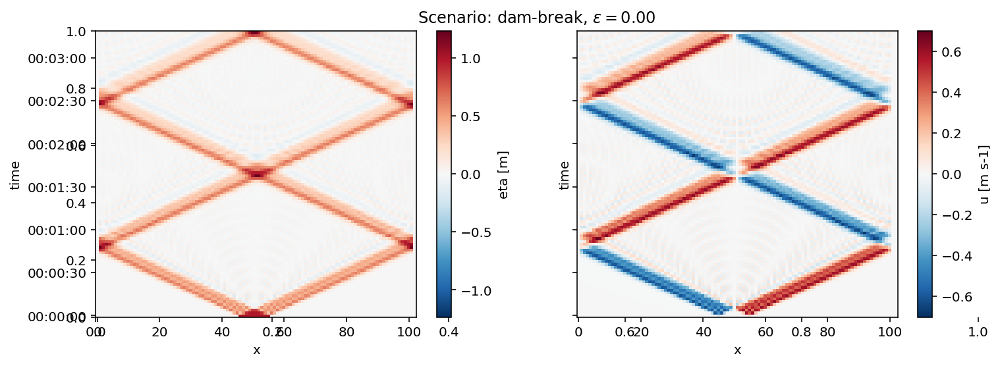

In [115]:
filename = long_waves(mode='dam-break', eps=0.0)
plot_long_waves(filename)

In [116]:
animate_long_waves(filename)

$\epsilon = 0.05$

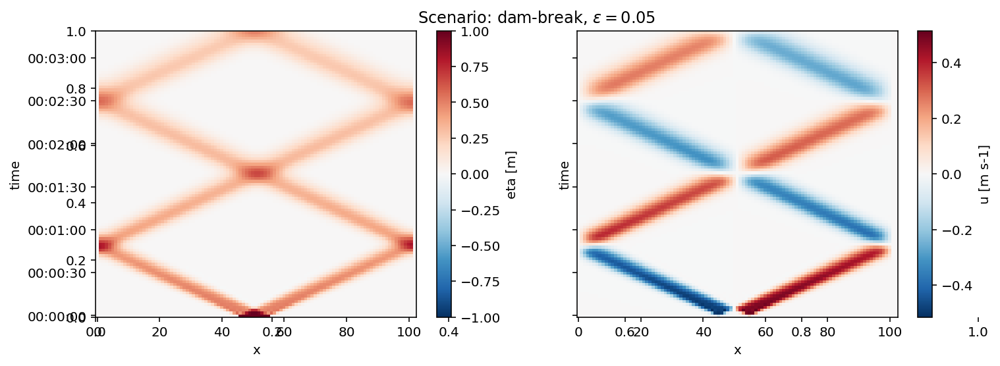

In [117]:
filename = long_waves(mode='dam-break', eps=0.05)
plot_long_waves(filename)

In [118]:
animate_long_waves(filename)

#### Scenaro 2: Wave Paddle

$\epsilon = 0$

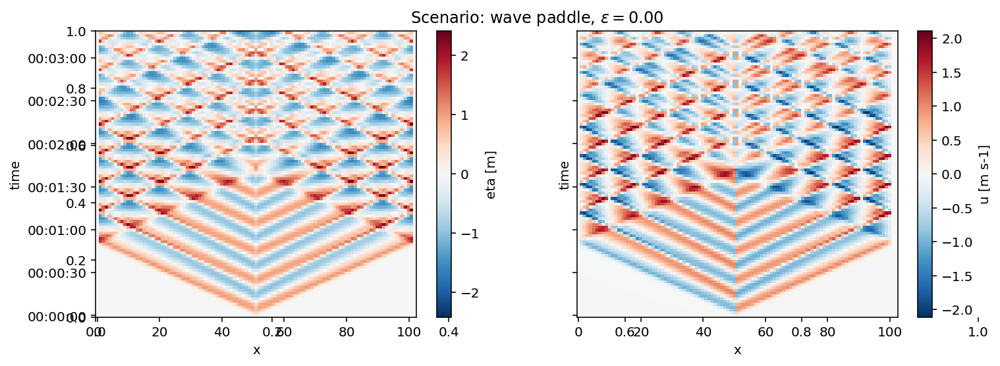

In [119]:
filename = long_waves(mode='wave paddle', eps=0.0)
plot_long_waves(filename)

In [120]:
animate_long_waves(filename)

$\epsilon = 0.05$

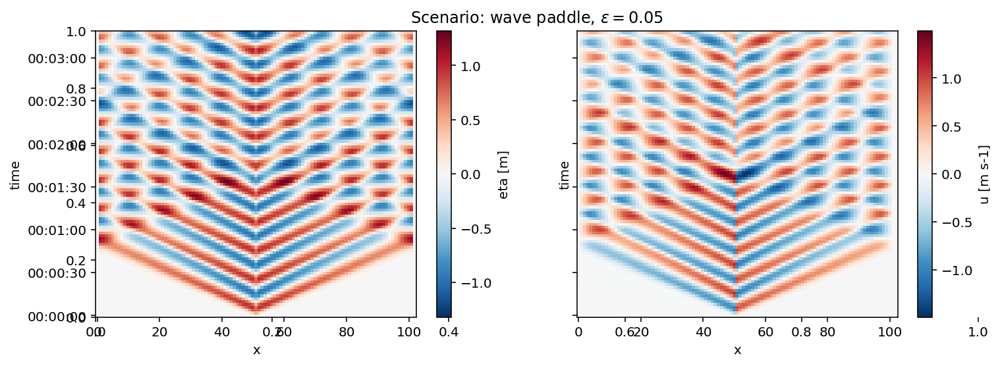

In [121]:
filename = long_waves(mode='wave paddle', eps=0.05)
plot_long_waves(filename)

In [122]:
animate_long_waves(filename)

- - -
## Problem 5

We also could show 'snap shots' in time which represent the model at specific times (such as Fig 4.14 and Fig 4.15). Implement a visualization subroutine that shows only the sea level height (eta) at different times. Either arrange your figure with 3 by 2 subplots following Fig 4.14 and Fig 4.15 or create an animation. As in those figures, include in a dotted line showing the 'equilibrium' sea surface height.  

Produce your visualization to both the *dam-break* and *wave paddle* scenarios described in OMB Exercise 5 using a value of $\epsilon = 0.03$ for the Shapiro filter.

- - -

## OMB 4.4 Exercise 6: The Flooding Algorithm

--- 
## Problem 6

Modify the program `long_waves()` to implement the flooding algorithm discussed in OMB 4.4 Exercise 6. Although your program is to be written in Python, you may find the provided FORTRAN code for Exercise 6 from the textbook as a useful resource.  

Run your model for the two scenarios as described in section 4.4.5 ("tsunami" and "avalanche").  Your solution should include plots and/or animations very similar to Fig 4.14 and Fig 4.15 (use your visualization you developed in Problem 5).

---
